# Exploration of mechanism

In [2]:
using Colors
using Graphs
using Plots
using Random: MersenneTwister
using StatsBase: mean, std, countmap

include("../src/ColorScheme.jl")
using .ColorScheme: DARK_RED, LIGHT_RED, GRAY, LIGHT_BLUE, DARK_BLUE, COLOR_GRAD

include("../src/Network.jl")
using .Network: create_weighted_cycle_graph, create_cycle_graph, desc, plot_degree_distribution, mat_nv, mat_ne, mat_degree, mat_update_weight!, plot_graph, average_distance

include("../src/EnvironmentalVariability.jl")
using .EnvironmentalVariability: ar1

include("../src/Simulation.jl")
using .Simulation: Param, Model, run!, Strategy, C, D

println("Julia $(VERSION)")
println("Thread count: $(Threads.nthreads())")

Julia 1.10.2
Thread count: 12


In [3]:
strategies_to_colors(strategy_vec::Vector{Strategy})::Vector{RGB} = [s == C ? DARK_BLUE : DARK_RED for s in strategy_vec]

function moving_average(data::Vector{Float64}, window_size::Int = 10)::Vector{Float64}
    return [mean(data[max(1, i-window_size):min(end, i+window_size)]) for i in 1:length(data)]
end;

## Execution 1 

In [5]:
C_rate₀ = 0.0
b = 1.8
relationship_increment_factor = 1.0
resource_decrement_factor = 0.02
resource_limit_μ = 0.5
resource_limit_β = 0.0
resource_limit_σ = 0.0
peak_node_variability = 16
random_seed = 3
# 2 上がり方が汚い、下がり方は綺麗

p = Param(
    N = 100, k₀ = 4, generations = 10_000,
    b = b,
    C_rate₀ = C_rate₀,
    peak_node_variability = peak_node_variability,
    relationship_increment_factor = relationship_increment_factor,
    resource_decrement_factor = resource_decrement_factor,
    resource_limit_μ = resource_limit_μ,
    resource_limit_β = resource_limit_β,
    resource_limit_σ = resource_limit_σ,
)
m = Model(p, MersenneTwister(random_seed))
C_rate_vec, average_resource_vec, death_count_vec, peak_node_vec, strategy_mat, degree_mat, average_distance_vec, clustering_coefficient_vec, average_C_neighbour_rate_vec = run!(m, MersenneTwister(random_seed));

## Analysis 1

peak_node_variability: 16, resource_decrement_factor: 0.02, resource_limit_μ: 0.5, resource_limit_β: 0.0
C_rate: 0.4951029794041191
average_resource: 0.6447018171600319
Average Degree (k̄):	 4.0
Average Distance (L):	 3.391121397012413
Average Clustering Coefficient (C):	 0.03241296518607443


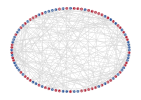

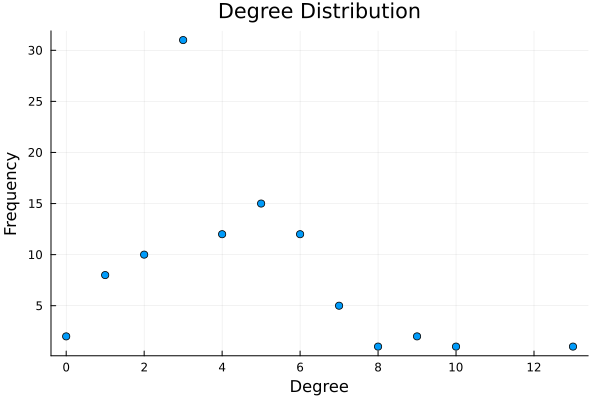

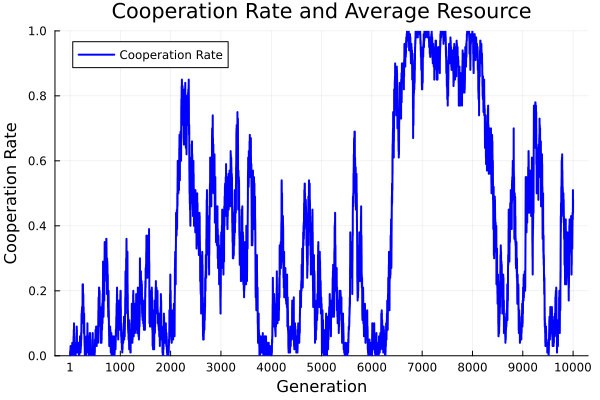

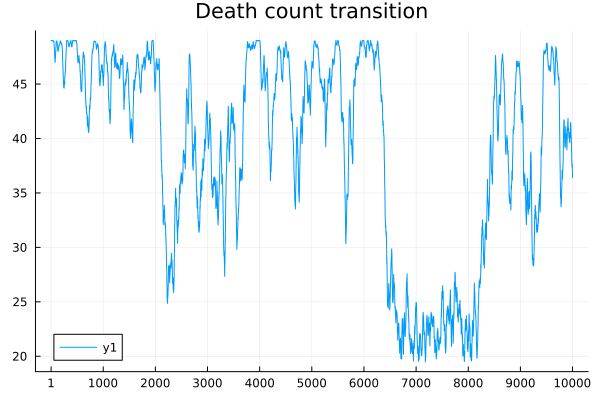

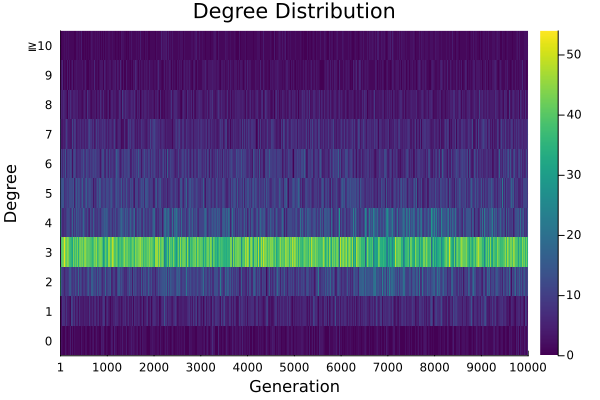

...

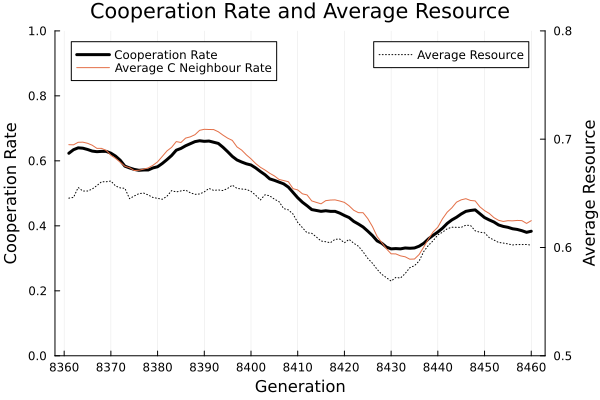

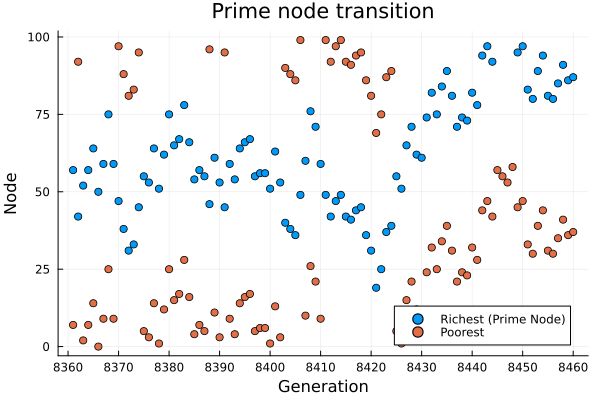

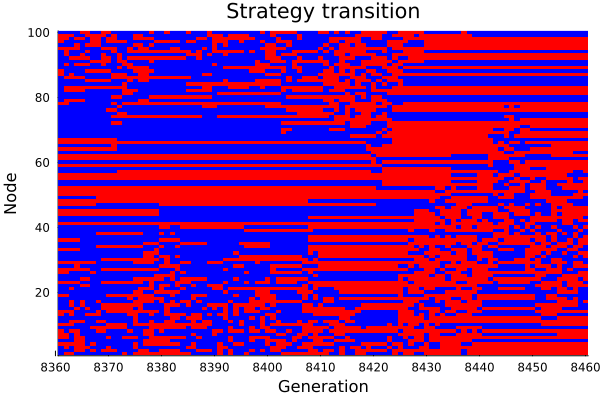

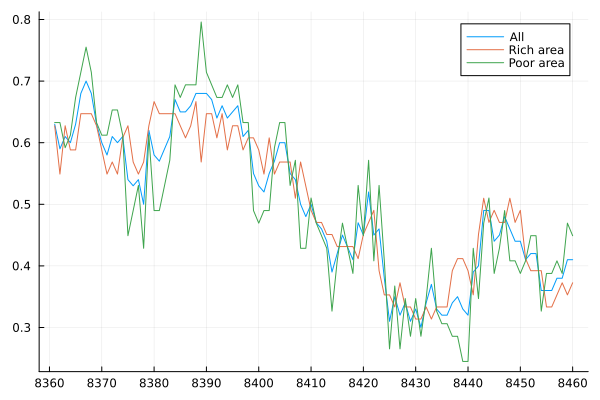

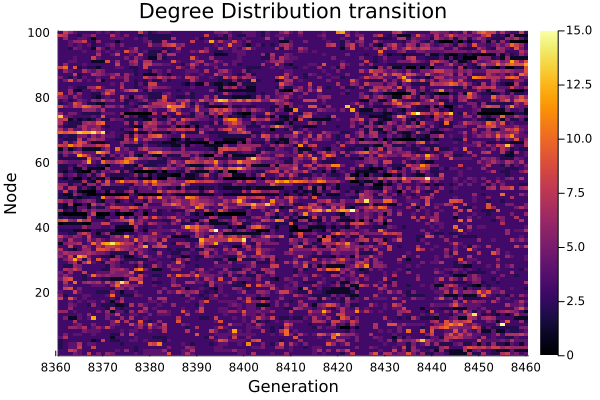

In [7]:
println("peak_node_variability: $(peak_node_variability), resource_decrement_factor: $(resource_decrement_factor), resource_limit_μ: $(resource_limit_μ), resource_limit_β: $(resource_limit_β)")
println("C_rate: $(mean(C_rate_vec[round(Int, end * 0.5):end]))")
println("average_resource: $(mean(average_resource_vec[round(Int, end * 0.5):end]))")
g = SimpleGraph(m.relation_mat)
desc(g)
plot_graph(m.relation_mat, strategies_to_colors(m.strategy_vec))
plot_degree_distribution(g)

xticks = collect(0:1000:m.p.generations)
xticks[1] = 1

title = "Cooperation Rate and Average Resource"
p = plot(C_rate_vec, xticks=xticks, 
    label="Cooperation Rate", color=:blue, linewidth=2, legend=:topleft, 
    xlabel="Generation", ylabel="Cooperation Rate", ylim=(0, 1), title=title)
# plot!(moving_average(average_C_neighbour_rate_vec, 10), label="Average C Neighbour Rate")
# plot!(twinx(), moving_average(average_resource_vec, 10),
#     label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
#     ylabel="Average Resource", ylim=(0, 1))
display(p)

# heatmap(transpose(strategy_mat .== C), color=[:red, :blue], xlabel="Generation", xticks=xticks, ylabel="Node", title="Strategy transition") |> display

p1 = plot(moving_average(death_count_vec), xticks=xticks, title="Death count transition")
# p2 = plot(peak_node_vec, xticks=xticks, title="Prime node transition")
# plot(p1, p2, layout=(1, 2), size=(1000, 400)) |> display
display(p1)

# Degree
degree_distribution_vec = [countmap(degree_mat[gen, :]) for gen in 1:m.p.generations]
heatmap_data = zeros(Int, 11, m.p.generations)
for gen in 1:m.p.generations
    for (degree, count) in degree_distribution_vec[gen]
        if degree > 10
            heatmap_data[11, gen] += count
        else
            heatmap_data[degree + 1, gen] = count
        end
    end
end
yticks = string.(collect(0:10))
yticks[11] = "≧10"
heatmap(heatmap_data, xlabel="Generation", ylabel="Degree", xticks=xticks, yticks=(1:length(yticks), yticks), title="Degree Distribution", color=:viridis) |> display

p3 = heatmap(transpose(degree_mat), xlabel="Generation", ylabel="Node", xticks=xticks, title="Degree Distribution transition")
p4 = plot(title="Degree transition", xticks=xticks)
plot!(moving_average(vec(std(degree_mat, dims=2))), color=:blue, label="SD")
# plot!(twinx(), maximum(degree_mat, dims=2), color=:red, label="Max")
plot(p3, p4, layout=(1, 2), size=(1000, 400)) |> display

# L and C
plot(
    plot(moving_average(average_distance_vec), xticks=xticks, title="Average distance (L) transition"),
    plot(moving_average(clustering_coefficient_vec), xticks=xticks, title="Clustering coefficient (C) transition"),
    layout=(1, 2),
    size=(1000, 400)
) |> display

# detail
range = 6341:6440
xticks = 6340:10:6440
h_xticks = (0:10:100, xticks)

title = "Cooperation Rate and Average Resource"
p = plot(range, moving_average(C_rate_vec[range], 5), xticks=xticks, 
    label="Cooperation Rate", color=:black, linewidth=3, legend=:topleft, 
    xlabel="Generation", ylabel="Cooperation Rate", ylim=(0, 1), title=title)
plot!(range, moving_average(average_C_neighbour_rate_vec[range], 5), label="Average C Neighbour Rate")
plot!(twinx(), range, moving_average(average_resource_vec[range], 5),
    label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
    ylabel="Average Resource", ylim=(0.5, 0.8))
display(p)

# title="Death count transition"
# plot(range, death_count_vec[range], xticks=xticks, label=false, xlabel="Generation", ylabel="Death count", title=title) |> display

title = "Prime node transition"
p = scatter(range, peak_node_vec[range], label="Richest (Prime Node)", xticks=xticks, xlabel="Generation", ylabel="Node", title=title)
scatter!(range, mod.(peak_node_vec[range] .+ 50, 100), label="Poorest")
display(p)

title = "Strategy transition"
heatmap(transpose(strategy_mat .== C)[:, range], color=[:red, :blue], xticks=h_xticks, xlabel="Generation", ylabel="Node", title=title, colorbar=false) |> display

rich_area_C_rate = []
poor_area_C_rate = []
for t in range
    prime_node = peak_node_vec[t]
    rich_area_start = mod(peak_node_vec[t] - 25, 100)
    rich_area_end = mod(peak_node_vec[t] + 25, 100)
    rich_area_nodes = collect(rich_area_start:rich_area_end)
    if rich_area_start > rich_area_end
        rich_area_nodes = [collect(rich_area_start:100); collect(1:rich_area_end)]
    end
    poor_area_nodes = [x for x in 1:100 if x ∉ rich_area_nodes]
    push!(rich_area_C_rate, mean(strategy_mat[t, rich_area_nodes] .== C))
    push!(poor_area_C_rate, mean(strategy_mat[t, poor_area_nodes] .== C))
end
p = plot(range, C_rate_vec[range], xticks=xticks, label="All")
plot!(range, rich_area_C_rate, label="Rich area")
plot!(range, poor_area_C_rate, label="Poor area")
display(p)

title = "Degree Distribution transition"
heatmap(transpose(degree_mat)[:, range], xlabel="Generation", ylabel="Node", xticks=h_xticks, title=title) |> display

#==================#
range = 8361:8460
xticks = 8360:10:8460
h_xticks = (0:10:100, xticks)

title = "Cooperation Rate and Average Resource"
p = plot(range, moving_average(C_rate_vec[range], 5), xticks=xticks, 
    label="Cooperation Rate", color=:black, linewidth=3, legend=:topleft, 
    xlabel="Generation", ylabel="Cooperation Rate", ylim=(0, 1.0), title=title)
plot!(range, moving_average(average_C_neighbour_rate_vec[range], 5), label="Average C Neighbour Rate")
plot!(twinx(), range, moving_average(average_resource_vec[range], 5),
    label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
    ylabel="Average Resource", ylim=(0.5, 0.8))
display(p)

# title="Death count transition"
# plot(range, death_count_vec[range], xticks=xticks, label=false, xlabel="Generation", ylabel="Death count", title=title) |> display

title = "Prime node transition"
p = scatter(range, peak_node_vec[range], label="Richest (Prime Node)", xticks=xticks, xlabel="Generation", ylabel="Node", title=title)
scatter!(range, mod.(peak_node_vec[range] .+ 50, 100), label="Poorest")
display(p)

title = "Strategy transition"
heatmap(transpose(strategy_mat .== C)[:, range], color=[:red, :blue], xticks=h_xticks, xlabel="Generation", ylabel="Node", title=title, colorbar=false) |> display

rich_area_C_rate = []
poor_area_C_rate = []
for t in range
    prime_node = peak_node_vec[t]
    rich_area_start = mod(peak_node_vec[t] - 25, 100) + 1
    rich_area_end = mod(peak_node_vec[t] + 25, 100) + 1
    rich_area_nodes = collect(rich_area_start:rich_area_end)
    if rich_area_start > rich_area_end
        rich_area_nodes = [collect(rich_area_start:100); collect(1:rich_area_end)]
    end
    poor_area_nodes = [x for x in 1:100 if x ∉ rich_area_nodes]
    push!(rich_area_C_rate, mean(strategy_mat[t, rich_area_nodes] .== C))
    push!(poor_area_C_rate, mean(strategy_mat[t, poor_area_nodes] .== C))
end
p = plot(range, C_rate_vec[range], xticks=xticks, label="All")
plot!(range, rich_area_C_rate, label="Rich area")
plot!(range, poor_area_C_rate, label="Poor area")
display(p)

title = "Degree Distribution transition"
heatmap(transpose(degree_mat)[:, range], xlabel="Generation", ylabel="Node", xticks=h_xticks, title=title) |> display

## Execution 2

In [9]:
C_rate₀ = 0.0
b = 1.8
relationship_increment_factor = 1.0
resource_decrement_factor = 0.02
resource_limit_μ = 0.5
resource_limit_β = 0.8
resource_limit_σ = 0.1
peak_node_variability = 0
random_seed = 2;

In [10]:
p = Param(
    N = 100, k₀ = 4, generations = 10_000,
    b = b,
    C_rate₀ = C_rate₀,
    peak_node_variability = peak_node_variability,
    relationship_increment_factor = relationship_increment_factor,
    resource_decrement_factor = resource_decrement_factor,
    resource_limit_μ = resource_limit_μ,
    resource_limit_β = resource_limit_β,
    resource_limit_σ = resource_limit_σ,
)
m = Model(p, MersenneTwister(random_seed))
C_rate_vec, average_resource_vec, death_count_vec, peak_node_vec, strategy_mat, degree_mat, average_distance_vec, clustering_coefficient_vec, average_C_neighbour_rate_vec = run!(m, MersenneTwister(random_seed));

## Analysis 2

peak_node_variability: 0, resource_decrement_factor: 0.02, resource_limit_μ: 0.5, resource_limit_β: 0.8
C_rate: 0.4346330733853229
average_resource: 0.6323751953535154
Average Degree (k̄):	 4.0
Average Distance (L):	 3.431869717584003
Average Clustering Coefficient (C):	 0.035545023696682464


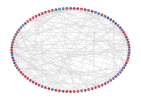

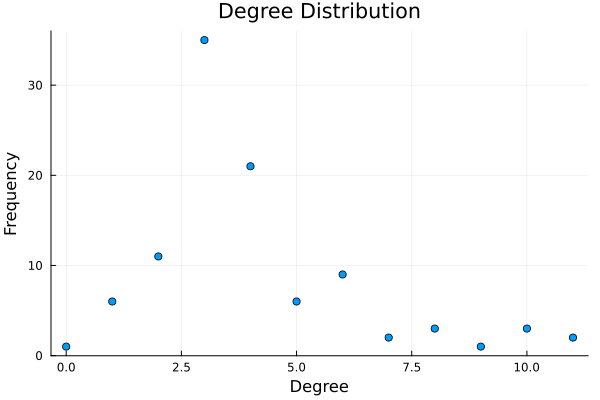

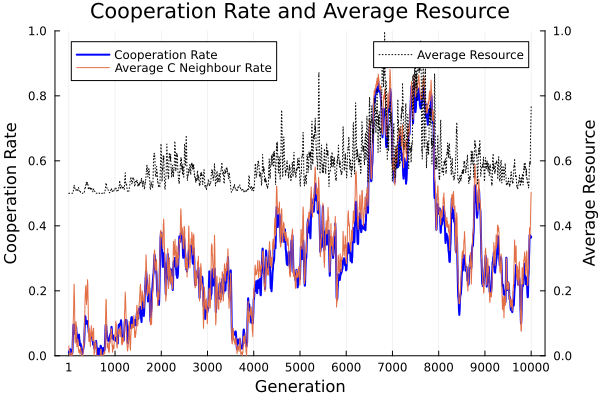

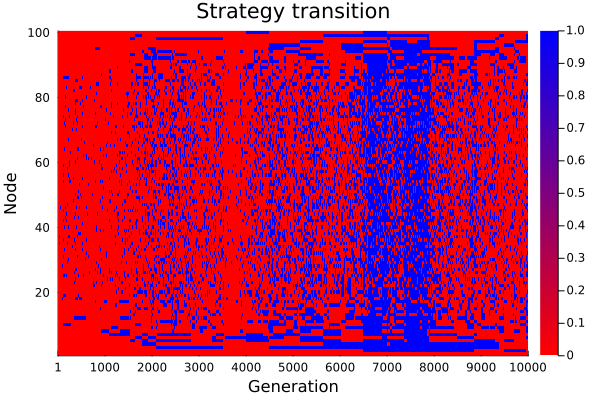

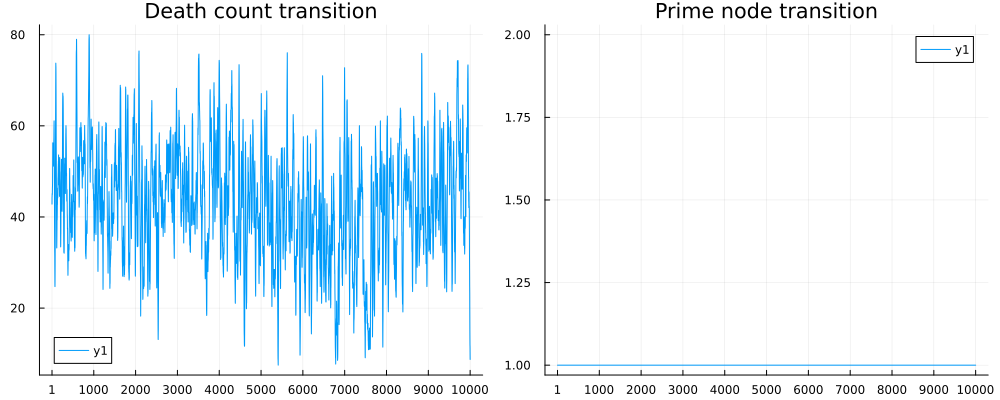

...

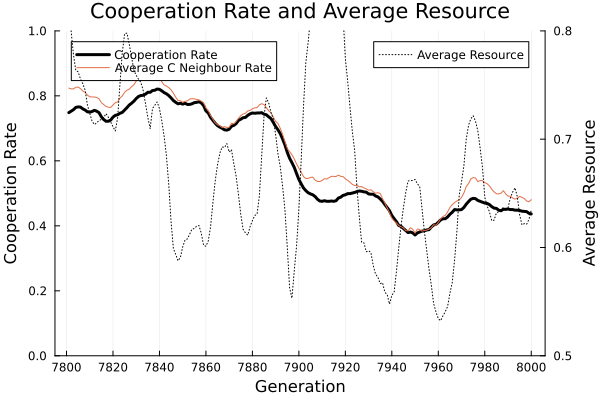

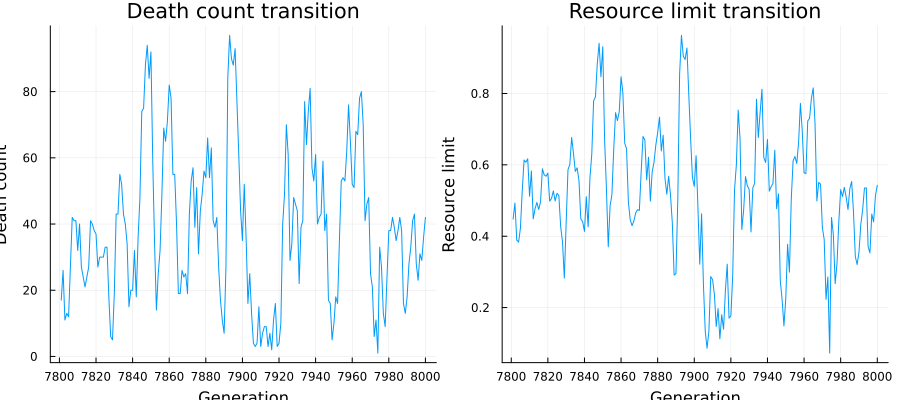

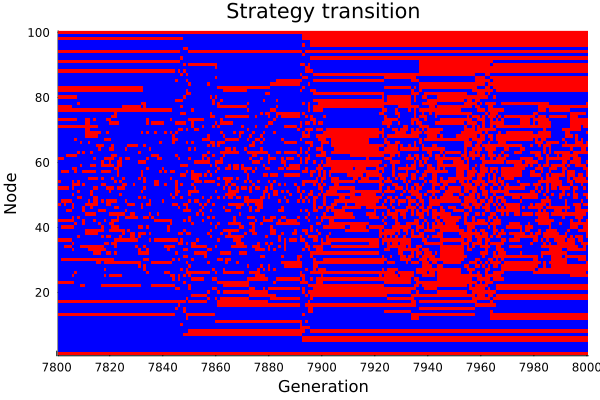

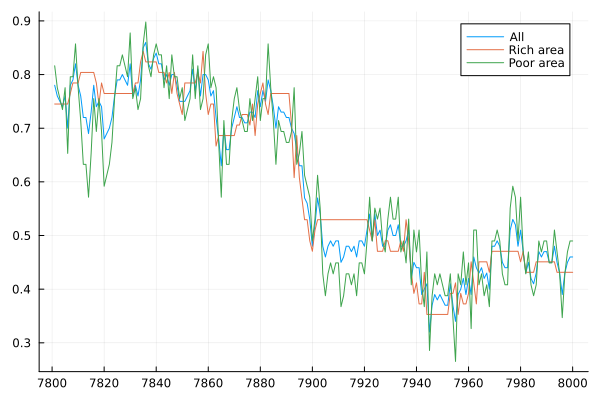

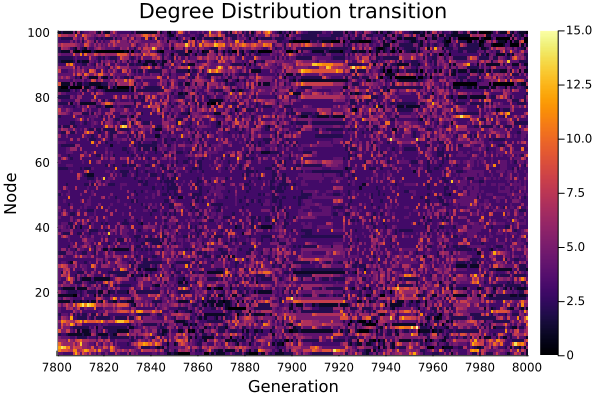

In [12]:
println("peak_node_variability: $(peak_node_variability), resource_decrement_factor: $(resource_decrement_factor), resource_limit_μ: $(resource_limit_μ), resource_limit_β: $(resource_limit_β)")
println("C_rate: $(mean(C_rate_vec[round(Int, end * 0.5):end]))")
println("average_resource: $(mean(average_resource_vec[round(Int, end * 0.5):end]))")
g = SimpleGraph(m.relation_mat)
desc(g)
plot_graph(m.relation_mat, strategies_to_colors(m.strategy_vec))
plot_degree_distribution(g)

xticks = collect(0:1000:m.p.generations)
xticks[1] = 1

title = "Cooperation Rate and Average Resource"
p = plot(moving_average(C_rate_vec), xticks=xticks, 
    label="Cooperation Rate", color=:blue, linewidth=2, legend=:topleft, 
    xlabel="Generation", ylabel="Cooperation Rate", ylim=(0, 1), title=title)
plot!(moving_average(average_C_neighbour_rate_vec), label="Average C Neighbour Rate")
plot!(twinx(), moving_average(average_resource_vec),
    label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
    ylabel="Average Resource", ylim=(0, 1))
display(p)

heatmap(transpose(strategy_mat .== C), color=[:red, :blue], xlabel="Generation", xticks=xticks, ylabel="Node", title="Strategy transition") |> display

p1 = plot(moving_average(death_count_vec), xticks=xticks, title="Death count transition")
p2 = plot(peak_node_vec, xticks=xticks, title="Prime node transition")
plot(p1, p2, layout=(1, 2), size=(1000, 400)) |> display

plot(moving_average(m.resource_limit_vec), xticks=xticks, title="Resource limit transition") |> display

# Degree
degree_distribution_vec = [countmap(degree_mat[gen, :]) for gen in 1:m.p.generations]
heatmap_data = zeros(Int, 11, m.p.generations)
for gen in 1:m.p.generations
    for (degree, count) in degree_distribution_vec[gen]
        if degree > 10
            heatmap_data[11, gen] += count
        else
            heatmap_data[degree + 1, gen] = count
        end
    end
end
yticks = string.(collect(0:10))
yticks[11] = "≧10"
heatmap(heatmap_data, xlabel="Generation", ylabel="Degree", xticks=xticks, yticks=(1:length(yticks), yticks), title="Degree Distribution", color=:viridis) |> display

p3 = heatmap(transpose(degree_mat), xlabel="Generation", ylabel="Node", xticks=xticks, title="Degree Distribution transition")
p4 = plot(title="Degree transition", xticks=xticks)
plot!(moving_average(vec(std(degree_mat, dims=2))), color=:blue, label="SD")
# plot!(twinx(), maximum(degree_mat, dims=2), color=:red, label="Max")
plot(p3, p4, layout=(1, 2), size=(1000, 400)) |> display

# L and C
plot(
    plot(moving_average(average_distance_vec), xticks=xticks, title="Average distance (L) transition"),
    plot(moving_average(clustering_coefficient_vec), xticks=xticks, title="Clustering coefficient (C) transition"),
    layout=(1, 2),
    size=(1000, 400)
) |> display

# detail
range = 6001:6200
xticks = 6000:20:6200
h_xticks = (0:20:200, xticks)

xlabel = "Generation"
title = "Cooperation Rate and Average Resource"
p = plot(range, moving_average(C_rate_vec[range], 5), xticks=xticks, 
    label="Cooperation Rate", color=:black, linewidth=3, legend=:topleft, 
    xlabel=xlabel, ylabel="Rate", ylim=(0, 1.0), title=title)
plot!(range, moving_average(average_C_neighbour_rate_vec[range], 5), label="Average C Neighbour Rate")
plot!(twinx(), range, moving_average(average_resource_vec[range], 5),
    label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
    ylabel="Average Resource", ylim=(0.5, 0.8))
display(p)

p1 = plot(range, death_count_vec[range], xticks=xticks, xlabel=xlabel, ylabel="Death count", title="Death count transition", label=false)
p2 = plot(range, m.resource_limit_vec[range], xticks=xticks, xlabel=xlabel, ylabel="Resource limit", title="Resource limit transition", label=false)
plot(p1, p2, layout=(1, 2), size=(900, 400)) |> display

title = "Strategy transition"
heatmap(transpose(strategy_mat .== C)[:, range], color=[:red, :blue], xticks=h_xticks, xlabel="Generation", ylabel="Node", title=title, colorbar=false) |> display

rich_area_C_rate = []
poor_area_C_rate = []
for t in range
    prime_node = peak_node_vec[t]
    rich_area_start = mod(peak_node_vec[t] - 25, 100)
    rich_area_end = mod(peak_node_vec[t] + 25, 100)
    rich_area_nodes = collect(rich_area_start:rich_area_end)
    if rich_area_start > rich_area_end
        rich_area_nodes = [collect(rich_area_start:100); collect(1:rich_area_end)]
    end
    poor_area_nodes = [x for x in 1:100 if x ∉ rich_area_nodes]
    push!(rich_area_C_rate, mean(strategy_mat[t, rich_area_nodes] .== C))
    push!(poor_area_C_rate, mean(strategy_mat[t, poor_area_nodes] .== C))
end
p = plot(range, C_rate_vec[range], xticks=xticks, label="All")
plot!(range, rich_area_C_rate, label="Rich area")
plot!(range, poor_area_C_rate, label="Poor area")
display(p)

title = "Degree Distribution transition"
heatmap(transpose(degree_mat)[:, range], xlabel="Generation", ylabel="Node", xticks=h_xticks, title=title) |> display

#==================#
range = 6401:6600
xticks = 6400:20:6600
h_xticks = (0:20:200, xticks)

xlabel = "Generation"
title = "Cooperation Rate and Average Resource"
p = plot(range, moving_average(C_rate_vec[range], 5), xticks=xticks, 
    label="Cooperation Rate", color=:black, linewidth=3, legend=:topleft, 
    xlabel=xlabel, ylabel="Rate", ylim=(0, 1.0), title=title)
plot!(range, moving_average(average_C_neighbour_rate_vec[range], 5), label="Average C Neighbour Rate")
plot!(twinx(), range, moving_average(average_resource_vec[range], 5),
    label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
    ylabel="Average Resource", ylim=(0.5, 0.8))
display(p)

p1 = plot(range, death_count_vec[range], xticks=xticks, xlabel=xlabel, ylabel="Death count", title="Death count transition", label=false)
p2 = plot(range, m.resource_limit_vec[range], xticks=xticks, xlabel=xlabel, ylabel="Resource limit", title="Resource limit transition", label=false)
plot(p1, p2, layout=(1, 2), size=(900, 400)) |> display

title = "Strategy transition"
heatmap(transpose(strategy_mat .== C)[:, range], color=[:red, :blue], xticks=h_xticks, xlabel="Generation", ylabel="Node", title=title, colorbar=false) |> display

rich_area_C_rate = []
poor_area_C_rate = []
for t in range
    prime_node = peak_node_vec[t]
    rich_area_start = mod(peak_node_vec[t] - 25, 100)
    rich_area_end = mod(peak_node_vec[t] + 25, 100)
    rich_area_nodes = collect(rich_area_start:rich_area_end)
    if rich_area_start > rich_area_end
        rich_area_nodes = [collect(rich_area_start:100); collect(1:rich_area_end)]
    end
    poor_area_nodes = [x for x in 1:100 if x ∉ rich_area_nodes]
    push!(rich_area_C_rate, mean(strategy_mat[t, rich_area_nodes] .== C))
    push!(poor_area_C_rate, mean(strategy_mat[t, poor_area_nodes] .== C))
end
p = plot(range, C_rate_vec[range], xticks=xticks, label="All")
plot!(range, rich_area_C_rate, label="Rich area")
plot!(range, poor_area_C_rate, label="Poor area")
display(p)

title = "Degree Distribution transition"
heatmap(transpose(degree_mat)[:, range], xlabel="Generation", ylabel="Node", xticks=h_xticks, title=title) |> display

#==================#
range = 7801:8000
xticks = 7800:20:8000
h_xticks = (0:20:200, xticks)

title = "Cooperation Rate and Average Resource"
p = plot(range, moving_average(C_rate_vec[range], 5), xticks=xticks, 
    label="Cooperation Rate", color=:black, linewidth=3, legend=:topleft, 
    xlabel="Generation", ylabel="Cooperation Rate", ylim=(0, 1.0), title=title)
plot!(range, moving_average(average_C_neighbour_rate_vec[range], 5), label="Average C Neighbour Rate")
plot!(twinx(), range, moving_average(average_resource_vec[range], 5),
    label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
    ylabel="Average Resource", ylim=(0.5, 0.8))
display(p)


p1 = plot(range, death_count_vec[range], xticks=xticks, label=false, xlabel="Generation", ylabel="Death count", title="Death count transition")
p2 = plot(range, m.resource_limit_vec[range], xticks=xticks, label=false, xlabel="Generation", ylabel="Resource limit", title="Resource limit transition")
plot(p1, p2, layout=(1, 2), size=(900, 400)) |> display

title = "Strategy transition"
heatmap(transpose(strategy_mat .== C)[:, range], color=[:red, :blue], xticks=h_xticks, xlabel="Generation", ylabel="Node", title=title, colorbar=false) |> display

rich_area_C_rate = []
poor_area_C_rate = []
for t in range
    prime_node = peak_node_vec[t]
    rich_area_start = mod(peak_node_vec[t] - 25, 100) + 1
    rich_area_end = mod(peak_node_vec[t] + 25, 100) + 1
    rich_area_nodes = collect(rich_area_start:rich_area_end)
    if rich_area_start > rich_area_end
        rich_area_nodes = [collect(rich_area_start:100); collect(1:rich_area_end)]
    end
    poor_area_nodes = [x for x in 1:100 if x ∉ rich_area_nodes]
    push!(rich_area_C_rate, mean(strategy_mat[t, rich_area_nodes] .== C))
    push!(poor_area_C_rate, mean(strategy_mat[t, poor_area_nodes] .== C))
end
p = plot(range, C_rate_vec[range], xticks=xticks, label="All")
plot!(range, rich_area_C_rate, label="Rich area")
plot!(range, poor_area_C_rate, label="Poor area")
display(p)

title = "Degree Distribution transition"
heatmap(transpose(degree_mat)[:, range], xlabel="Generation", ylabel="Node", xticks=h_xticks, title=title) |> display

## Experiment 3

In [14]:
C_rate₀ = 0.0
b = 0.7
relationship_increment_factor = 1.2
resource_decrement_factor = 0.02
resource_limit_μ = 0.5
resource_limit_β = 0.0
resource_limit_σ = 0.0
peak_node_variability = 4
random_seed = 1

p = Param(
    N = 100, k₀ = 4, generations = 10_000,
    b = b,
    C_rate₀ = C_rate₀,
    peak_node_variability = peak_node_variability,
    relationship_increment_factor = relationship_increment_factor,
    resource_decrement_factor = resource_decrement_factor,
    resource_limit_μ = resource_limit_μ,
    resource_limit_β = resource_limit_β,
    resource_limit_σ = resource_limit_σ,
)
m = Model(p, MersenneTwister(random_seed))
C_rate_vec, average_resource_vec, death_count_vec, peak_node_vec, strategy_mat, degree_mat, average_distance_vec, clustering_coefficient_vec, average_C_neighbour_rate_vec = run!(m, MersenneTwister(random_seed));

## Analysis 3

peak_node_variability: 4, resource_decrement_factor: 0.02, resource_limit_μ: 0.5, resource_limit_β: 0.0
C_rate: 0.788878224355129
average_resource: 0.450255312839635
Average Degree (k̄):	 4.0
Average Distance (L):	 3.309344299748686
Average Clustering Coefficient (C):	 0.05029940119760479


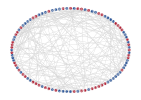

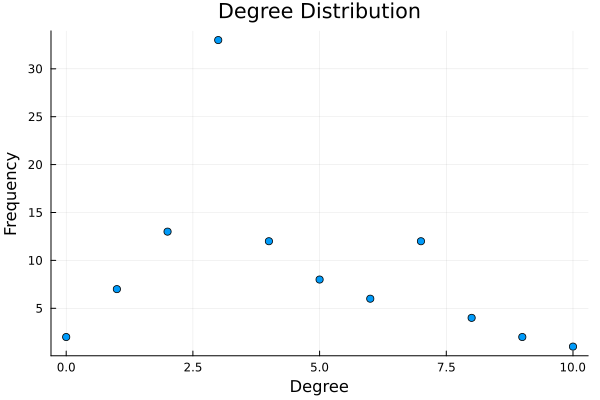

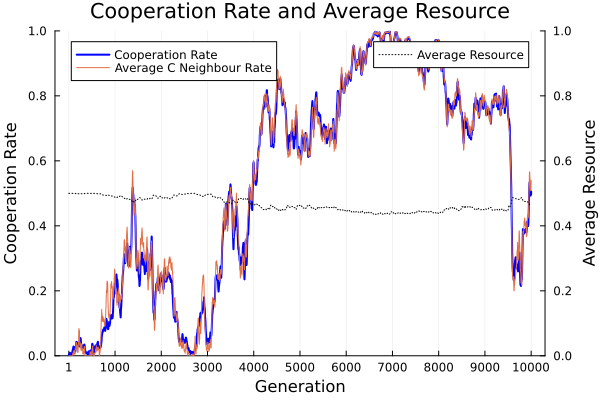

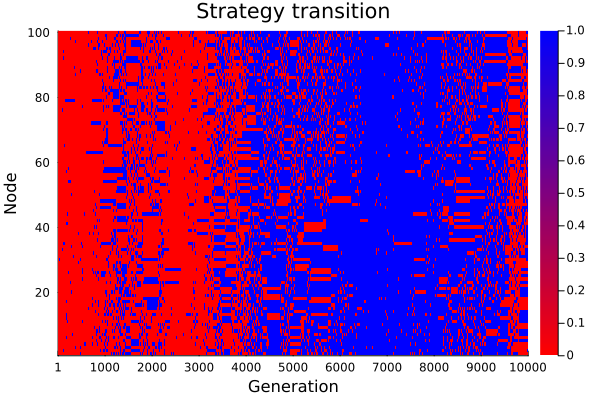

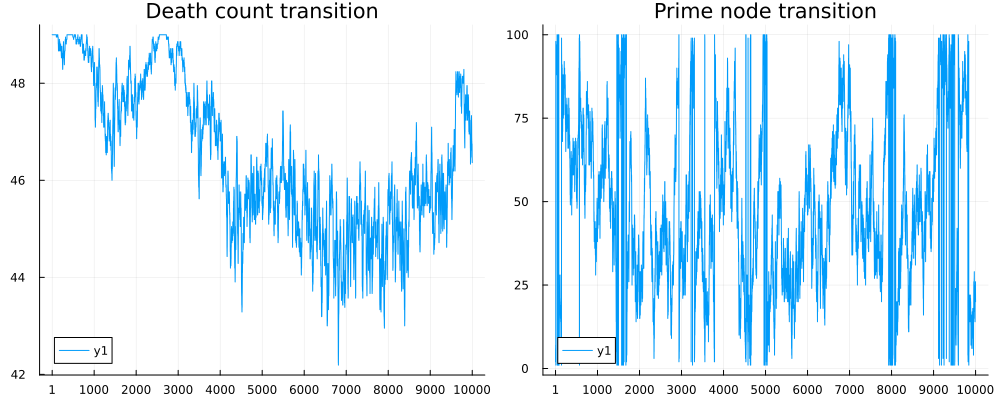

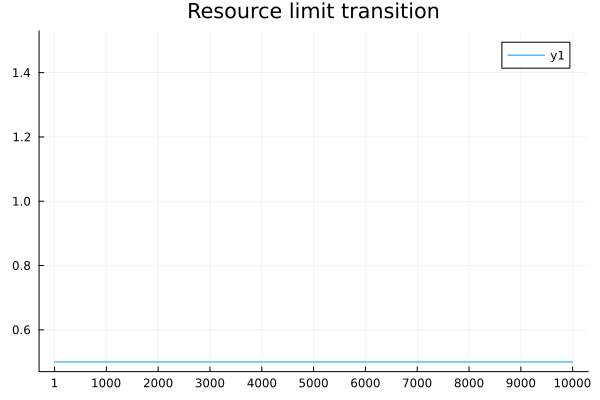

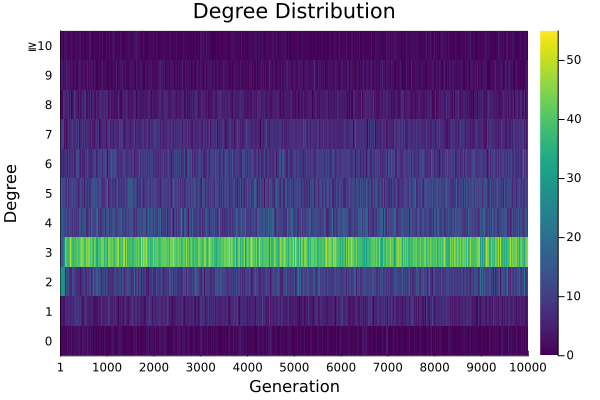

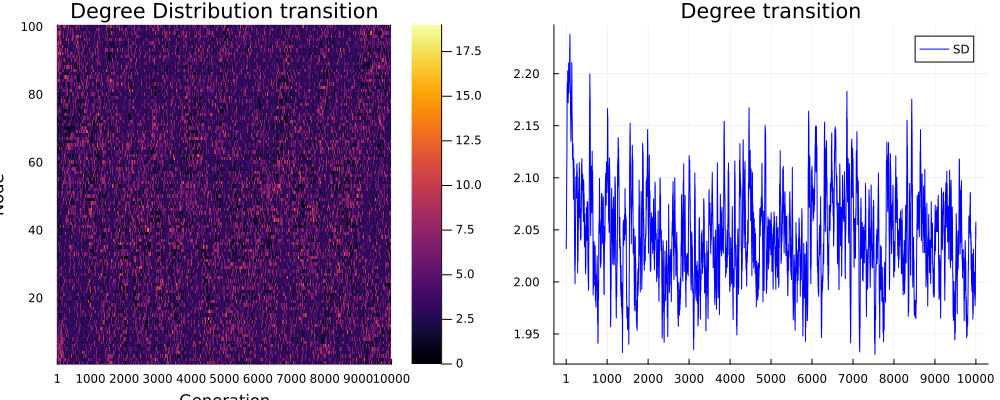

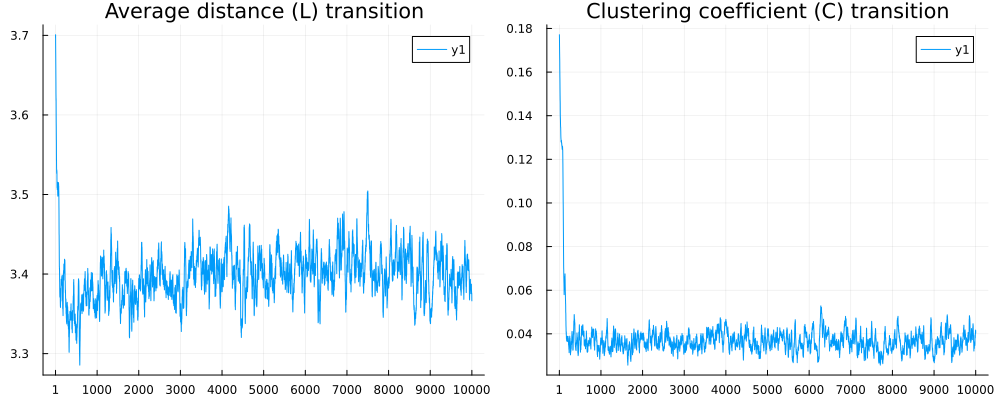

In [16]:
println("peak_node_variability: $(peak_node_variability), resource_decrement_factor: $(resource_decrement_factor), resource_limit_μ: $(resource_limit_μ), resource_limit_β: $(resource_limit_β)")
println("C_rate: $(mean(C_rate_vec[round(Int, end * 0.5):end]))")
println("average_resource: $(mean(average_resource_vec[round(Int, end * 0.5):end]))")
g = SimpleGraph(m.relation_mat)
desc(g)
plot_graph(m.relation_mat, strategies_to_colors(m.strategy_vec))
plot_degree_distribution(g)

xticks = collect(0:1000:m.p.generations)
xticks[1] = 1

title = "Cooperation Rate and Average Resource"
p = plot(moving_average(C_rate_vec), xticks=xticks, 
    label="Cooperation Rate", color=:blue, linewidth=2, legend=:topleft, 
    xlabel="Generation", ylabel="Cooperation Rate", ylim=(0, 1), title=title)
plot!(moving_average(average_C_neighbour_rate_vec), label="Average C Neighbour Rate")
plot!(twinx(), moving_average(average_resource_vec),
    label="Average Resource", color=:black, linestyle=:dot, legend=:topright,
    ylabel="Average Resource", ylim=(0, 1))
display(p)

heatmap(transpose(strategy_mat .== C), color=[:red, :blue], xlabel="Generation", xticks=xticks, ylabel="Node", title="Strategy transition") |> display

p1 = plot(moving_average(death_count_vec), xticks=xticks, title="Death count transition")
p2 = plot(peak_node_vec, xticks=xticks, title="Prime node transition")
plot(p1, p2, layout=(1, 2), size=(1000, 400)) |> display

plot(moving_average(m.resource_limit_vec), xticks=xticks, title="Resource limit transition") |> display

# Degree
degree_distribution_vec = [countmap(degree_mat[gen, :]) for gen in 1:m.p.generations]
heatmap_data = zeros(Int, 11, m.p.generations)
for gen in 1:m.p.generations
    for (degree, count) in degree_distribution_vec[gen]
        if degree > 10
            heatmap_data[11, gen] += count
        else
            heatmap_data[degree + 1, gen] = count
        end
    end
end
yticks = string.(collect(0:10))
yticks[11] = "≧10"
heatmap(heatmap_data, xlabel="Generation", ylabel="Degree", xticks=xticks, yticks=(1:length(yticks), yticks), title="Degree Distribution", color=:viridis) |> display

p3 = heatmap(transpose(degree_mat), xlabel="Generation", ylabel="Node", xticks=xticks, title="Degree Distribution transition")
p4 = plot(title="Degree transition", xticks=xticks)
plot!(moving_average(vec(std(degree_mat, dims=2))), color=:blue, label="SD")
# plot!(twinx(), maximum(degree_mat, dims=2), color=:red, label="Max")
plot(p3, p4, layout=(1, 2), size=(1000, 400)) |> display

# L and C
plot(
    plot(moving_average(average_distance_vec), xticks=xticks, title="Average distance (L) transition"),
    plot(moving_average(clustering_coefficient_vec), xticks=xticks, title="Clustering coefficient (C) transition"),
    layout=(1, 2),
    size=(1000, 400)
) |> display